# Simulating Caldera Environment

In [1]:
import numpy as np
from pyat.pyat import env
from matplotlib import pyplot as plt
import pyat_tools
import hvplot.xarray
from tqdm import tqdm
import scipy
import os
from scipy import signal
from pyat.pyat.readwrite import *

import xarray as xr
import hvplot.xarray

import pandas as pd

%load_ext autoreload
%autoreload 2

## Create Environment File

In [2]:
# Load SSP information
sspx = pyat_tools.load_ssp_from_file()
ssp_caldera_winter = pyat_tools.convert_SSP_arlpy(sspx, 0)[:-100]
ssp_caldera_summer = pyat_tools.convert_SSP_arlpy(sspx, 190)[:-100]

In [3]:
# Write Environment File
fn = 'caldera.env'
pyat_tools.build_env_file(ssp_caldera_winter,'env_files/caldera_top_mediumsandy.txt','env_files/caldera_bottom_mediumsandy.txt', fn)

# Write Environment File
#fn = 'caldera_summer.env'
#pyat_tools.build_env_file(ssp_caldera_summer,'env_files/caldera_top_mediumsandy.txt','env_files/caldera_bottom_mediumsandy.txt', fn)

## Simulate TDGF

In [32]:
fn = 'caldera'

# Write Environment file
pyat_tools.build_env_file(ssp_caldera_winter,'env_files/caldera_top_mediumsandy.txt','env_files/caldera_bottom_mediumsandy.txt', f'{fn}.env')

# Write field flp file
s_depths=[1499] #meters
ranges =  [3.2] #km
r_depths = [1499] # meters

pyat_tools.write_flp_file(s_depths, ranges, r_depths, fn)

removed .flp


In [34]:
# Build Frequency vector to accurate sample DTFT (so that x(t) can be reconstructed)
Fs = 200
To = 30

t, freq_half, freq_full = pyat_tools.get_freq_time_vectors(Fs, To)

N:	6000
To:	30 [s]
Δf	0.016666666666666666


In [35]:
# Simulate with Kraken
pressures = pyat_tools.simulate_FDGF('caldera', freq_half, [1, 20])

100%|██████████| 3001/3001 [00:12<00:00, 235.59it/s]


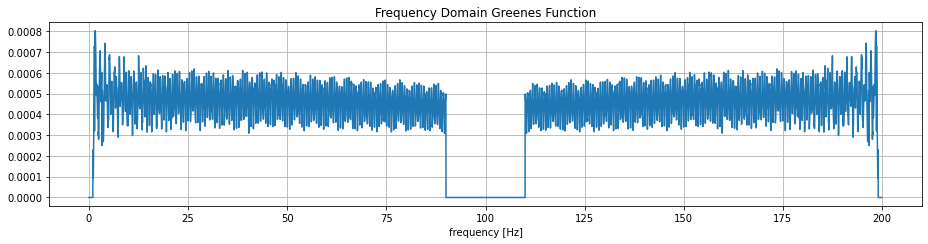

In [24]:
plt.figure(figsize=(13,3.5))
plt.plot(freq_full, np.abs(pressures))
plt.title('Frequency Domain Greenes Function')
plt.grid()
plt.xlabel('frequency [Hz]')
plt.tight_layout()

#plt.savefig('figures/FDGF_1_90.png', dpi=300)

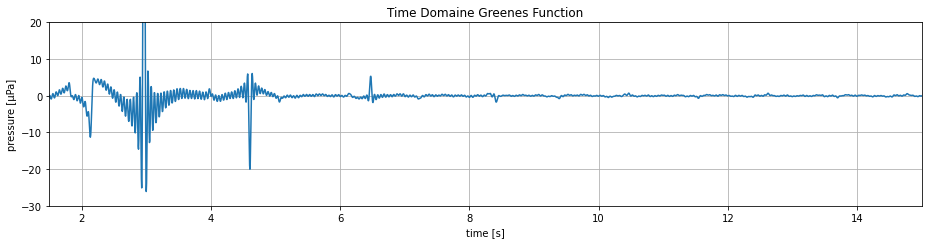

In [36]:
p_t = np.real(scipy.fft.ifft(pressures))

plt.figure(figsize=(13,3.5))
plt.plot(t, np.real(p_t)/1e-6)
plt.grid()
plt.xlim((t[0],t[-1]))
plt.xlabel('time [s]')
plt.ylabel('pressure [μPa]')
plt.title('Time Domaine Greenes Function')

plt.ylim((-30,20))
plt.xlim((1.5,15))
plt.tight_layout()
#plt.savefig(f'figures/TDGF_1_90_zoomedpng',dpi=300)

## Simulate TDGF (manually) 
- not using field.exe, but using physics equations

Use all the same setup code as with above code (using field.exe)

In [691]:
from scipy.special import hankel2

In [692]:
pressures = pyat_tools.simulate_FDGF_manual('caldera', freq_half, [1,20])

100%|██████████| 1501/1501 [00:04<00:00, 360.32it/s]


In [693]:
p_t_manual = np.real(scipy.fft.ifft(pressures))

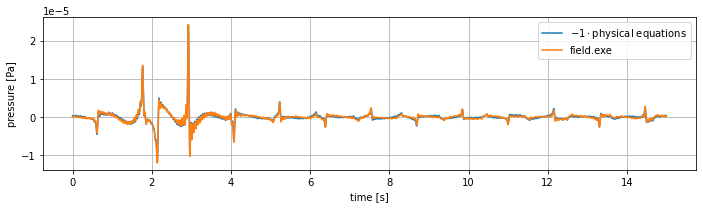

In [696]:
plt.figure(figsize=(10,3))

plt.plot(t, -p_t_manual, label='$-1\cdot$physical equations')
plt.plot(t, p_t, label='field.exe')
plt.grid()
plt.xlabel('time [s]')
plt.ylabel('pressure [Pa]')
plt.legend()
plt.tight_layout()


#plt.savefig('figures/field_vs_physics_flipped.png', dpi=300)

## Look at the effect of range

In [ ]:
ranges_ls = list(np.linspace(1,30, 30))

p_ts = []
for single_range in ranges_ls:
    # Write field flp file
    s_depths=[1499]
    ranges =  [single_range]
    r_depths = [1499]
    fn = 'caldera_winter'

    pyat_tools.write_flp_file(s_depths, ranges, r_depths, fn)

    # Build Frequency vector to accurate sample DTFT (so that x(t) can be reconstructed)
    Fs = 200
    To = 45

    t, freq_half, freq_full = pyat_tools.get_freq_time_vectors(Fs, To, verbose=False)

    # Simulate with Kraken
    pressures = pyat_tools.simulate_FDGF(fn, freq_half, [1,10])
    #pressures_f_summer = pyat_tools.simulate_FDGF('caldera_summer', freqs)

    #p_t_summer = scipy.fft.ifft(pressures_f_summer)
    p_t = scipy.fft.ifft(pressures)
    p_ts.append(p_t)


In [603]:
for k in range(30):
    plt.figure(figsize=(7,5))
    
    plt.plot(t, np.real(p_ts[k]))
    plt.xlim((t[0],t[-1]))
    #plt.ylim((-6e-5, 4e-5))
    plt.grid()
    plt.xlabel('time [s]')
    plt.ylabel('pressures [Pa]')
    plt.title(f'Reciever Range: {ranges_ls[k]:0.3} km')
    
    plt.savefig(f'TDGFs/45_{k}.png', dpi=300)
    plt.close()

## Group and Phase Velocities

In [86]:
freqs = list(np.linspace(10,90,100))
Δf = 0.1 #Hz 
fn = 'caldera'
modes = []
modes_df = []
for freq in tqdm(freqs):
    pyat_tools.change_env_freq(fn+'.env', freq)
    
    # delete mod and flp files
    try:
        os.remove(f'{fn}.mod')
    except FileNotFoundError:
        pass
    try:
        os.remove(f'{fn}.shd')
    except FileNotFoundError:
        pass
    
    os.system('kraken.exe caldera')
    options = {'fname':f'{fn}.mod', 'freq':freq}
    modes.append(read_modes(**options))

    # calculate modes for freqs + Δf
    pyat_tools.change_env_freq(fn+'.env', freq+Δf)
    # delete mod and flp files
    try:
        os.remove(f'{fn}.mod')
    except FileNotFoundError:
        pass
    try:
        os.remove(f'{fn}.shd')
    except FileNotFoundError:
        pass
    
    os.system('kraken.exe caldera')
    options = {'fname':f'{fn}.mod', 'freq':freq}
    modes_df.append(read_modes(**options))
    
    break
    

  0%|          | 0/100 [00:00<?, ?it/s]


In [82]:
phase_velocities = np.ones((len(freqs), 10))*np.nan
group_velocities = np.ones((len(freqs), 10))*np.nan
for k in range(len(freqs)):
    for mode in range(10):
        # Calculate Phase Speed (if mode exists)
        try:
            phase_velocities[k, mode] = 2*np.pi*freqs[k]/(np.real(modes[k].k[mode]))
        except IndexError:
            continue
           
        # Calculate Group Speed (if mode exists)
        try:
            group_velocities[k, mode] = 2*np.pi*(freq + Δf - freq)/(np.real(modes_df[k].k[mode]) - np.real(modes[k].k[mode]))
        except IndexError:
            continue

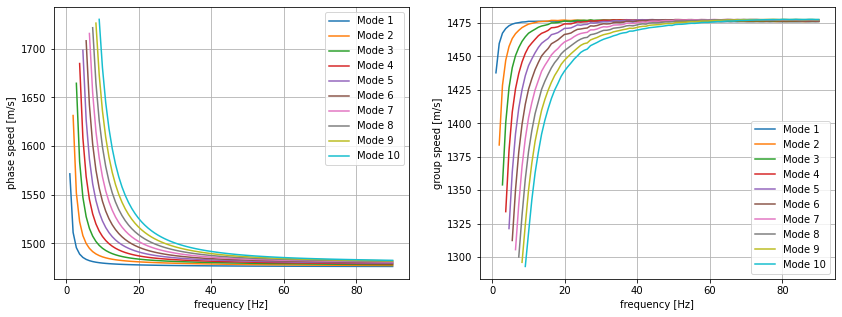

In [84]:
labels = [
    'Mode 1',
    'Mode 2',
    'Mode 3',
    'Mode 4',
    'Mode 5',
    'Mode 6',
    'Mode 7',
    'Mode 8',
    'Mode 9',
    'Mode 10',
]


plt.figure(figsize=(14,5))

plt.subplot(1,2,1)
plt.plot(freqs, phase_velocities, label=labels)
plt.grid()
plt.ylabel('phase speed [m/s]')
plt.xlabel('frequency [Hz]')
plt.title
plt.legend()

plt.subplot(1,2,2)
plt.plot(freqs, group_velocities, label=labels)
plt.grid()
plt.ylabel('group speed [m/s]')
plt.xlabel('frequency [Hz]')
plt.title
plt.legend()

plt.savefig('figures/group and phase speeds.png', dpi=300)

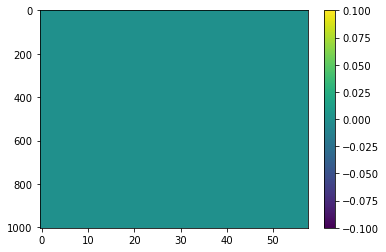

In [76]:
plt.imshow(np.imag(modes[0].phi), aspect='auto')
plt.colorbar()

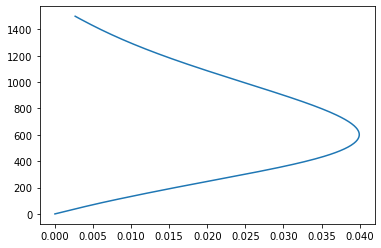

In [87]:
N = 0
plt.plot(np.real(modes[0].phi[:,N]),modes[0].z)

# Look at single mode TDGFs

In [196]:
# Write Environment File
fn = 'caldera.env'
alpha=0.01
pyat_tools.build_env_file(ssp_caldera_winter,'env_files/caldera_top_mediumsandy.txt','env_files/caldera_bottom_mediumsandy.txt', fn, alpha=alpha)

In [197]:
# Build Frequency vector to accurate sample DTFT (so that x(t) can be reconstructed)
Fs = 200
To = 45

t, freq_half, freq_full = pyat_tools.get_freq_time_vectors(Fs, To)

N:	9000
To:	45 [s]
Δf	0.011111111111111112


In [198]:
p_fc = pyat_tools.simulate_FDGF_manual('caldera', freq_half, fband=[1,10], krakenc=True)
p_f = pyat_tools.simulate_FDGF_manual('caldera', freq_half, fband=[1,10], krakenc=False)

100%|██████████| 4501/4501 [00:06<00:00, 725.33it/s]


In [199]:
p_t = np.real(scipy.fft.ifft(p_f))
p_tc = np.real(scipy.fft.ifft(p_fc))

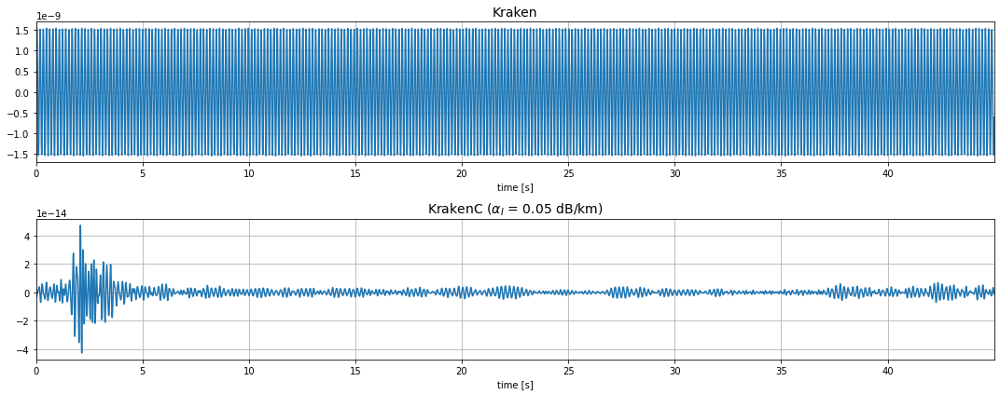

In [99]:
plt.figure(figsize=(15,6))

plt.subplot(2,1,1)
plt.plot(t, p_t)
plt.grid()
plt.xlabel('time [s]')
plt.title('Kraken', fontsize=14)
plt.xlim((t[0], t[-1]))

plt.subplot(2,1,2)
plt.title('KrakenC ($ \\alpha_I $ = 0.05 dB/km)', fontsize=14)
plt.plot(t, p_tc)
plt.grid()
plt.xlabel('time [s]')
plt.xlim((t[0], t[-1]))

plt.tight_layout()

plt.savefig('figures/krakenc/alpha_0-05.png', dpi=200)

(0.0, 10.0)

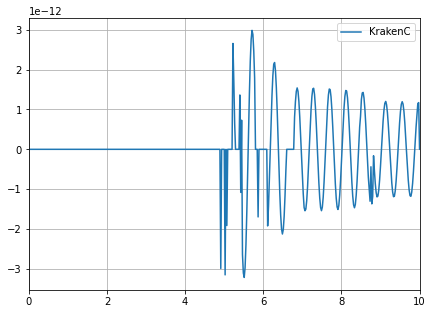

In [101]:
plt.figure(figsize=(7,5))
#plt.plot(freq_full, np.real(p_f), label='Kraken')
plt.plot(freq_full, np.real(p_fc), label='KrakenC')
plt.grid()
plt.legend()

plt.xlim((0,10))

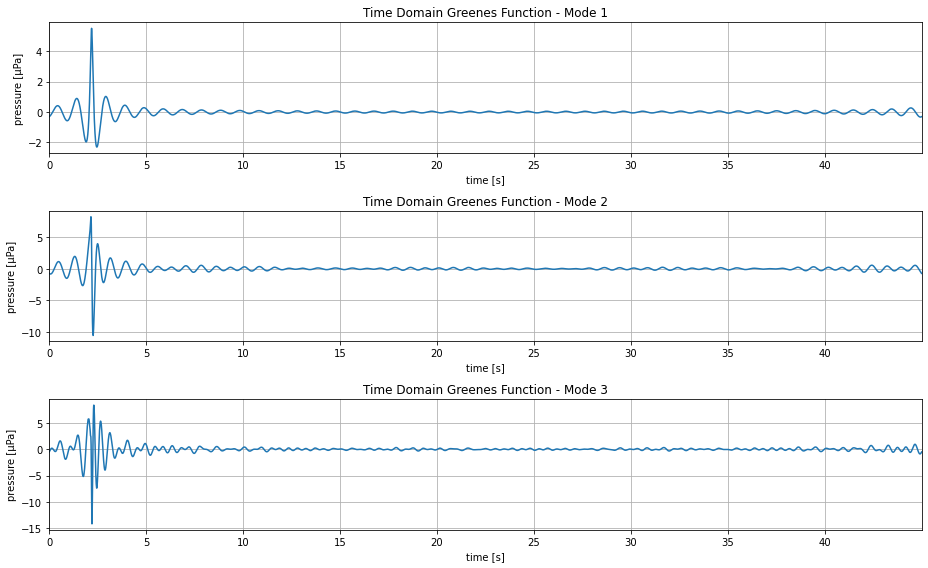

In [744]:
p_t1 = np.real(scipy.fft.ifft(pressures[0]))
p_t2 = np.real(scipy.fft.ifft(pressures[1]))
p_t3 = np.real(scipy.fft.ifft(pressures[2]))

plt.figure(figsize=(13,8))
plt.subplot(3,1,1)
plt.plot(t, np.real(p_t1)/1e-6, label='Mode 1')
plt.grid()
plt.xlim((t[0],t[-1]))
plt.xlabel('time [s]')
plt.ylabel('pressure [μPa]')
plt.title('Time Domain Greenes Function - Mode 1')

plt.subplot(3,1,2)
plt.plot(t, np.real(p_t2)/1e-6, label='Mode 2')
plt.grid()
plt.xlim((t[0],t[-1]))
plt.xlabel('time [s]')
plt.ylabel('pressure [μPa]')
plt.title('Time Domain Greenes Function - Mode 2')

plt.subplot(3,1,3)
plt.plot(t, np.real(p_t3)/1e-6, label='Mode 3')
plt.grid()
plt.xlim((t[0],t[-1]))
plt.xlabel('time [s]')
plt.ylabel('pressure [μPa]')
plt.title('Time Domain Greenes Function - Mode 3')

plt.tight_layout()

plt.savefig('Single Mode Simulation.png', dpi=300)

# Looking at Effects of KrakenC

In [191]:
# Write Environment File
fn = 'caldera.env'
alpha = 0.01
pyat_tools.build_env_file(ssp_caldera_winter,'env_files/caldera_top_mediumsandy.txt','env_files/caldera_bottom_mediumsandy.txt', fn, alpha=alpha)

# Write field flp file
s_depths= [1499]
ranges =  np.linspace(0,5,1000)
r_depths = np.linspace(0,1500,1000)
fn = 'caldera'

pyat_tools.write_flp_file(s_depths, ranges, r_depths, fn)

removed .flp


In [192]:
fn = 'caldera'

freq = 50
pyat_tools.change_env_freq(fn+'.env', freq)

# delete mod and shd files
try:
    os.remove(f'{fn}.mod')
except FileNotFoundError:
    pass
try:
    os.remove(f'{fn}.shd')
except FileNotFoundError:
    pass

os.system(f'krakenc.exe {fn}')
options = {'fname':f'{fn}.mod', 'freq':freq}
modec = read_modes(**options)
os.system(f'field.exe {fn}')
[ PlotTitle, PlotType, freqVec, atten, pos, pressure ] = read_shd(f'{fn}.shd')
pressure_xc = xr.DataArray(np.abs(pressure[0,0,:,:]), dims = ['depth', 'range'], coords={'depth':r_depths, 'range':ranges}, name='pressures')

# delete mod and flp files
try:
    os.remove(f'{fn}.mod')
except FileNotFoundError:
    pass
try:
    os.remove(f'{fn}.shd')
except FileNotFoundError:
    pass

os.system('kraken.exe caldera')
options = {'fname':f'{fn}.mod', 'freq':freq}
mode = read_modes(**options)
os.system(f'field.exe {fn}')
[ PlotTitle, PlotType, freqVec, atten, pos, pressure ] = read_shd(f'{fn}.shd')
pressure_x = xr.DataArray(np.abs(pressure[0,0,:,:]), dims = ['depth', 'range'], coords={'depth':r_depths, 'range':ranges}, name='pressures')

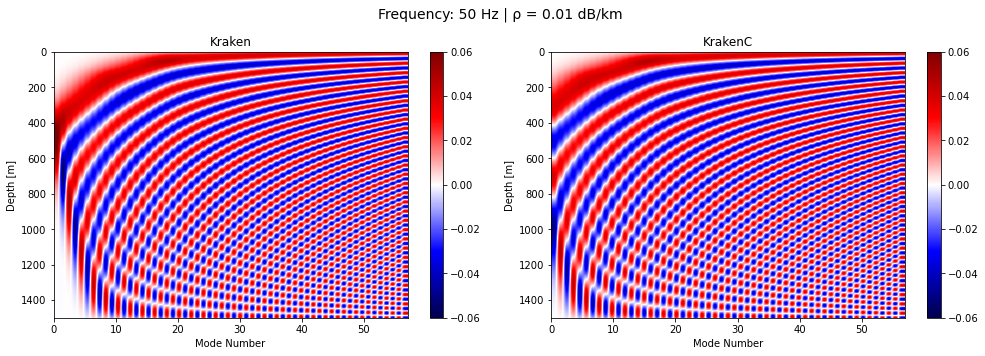

In [193]:
plt.figure(figsize=(14,5))

extent = [0, mode.M-1, 1500, 0]

plt.suptitle(f'Frequency: {freq} Hz | ρ = {alpha} dB/km', fontsize=14)
plt.subplot(1,2,1)
plt.imshow(np.real(mode.phi), aspect='auto', cmap='seismic', extent=extent, vmin=-0.06, vmax=0.06)
plt.colorbar()
plt.title('Kraken')
plt.xlabel('Mode Number')
plt.ylabel('Depth [m]')

plt.subplot(1,2,2)
plt.imshow(np.real(modec.phi), aspect='auto', cmap='seismic', extent=extent, vmin=-0.06, vmax=0.06)
plt.colorbar()
plt.title('KrakenC')
plt.xlabel('Mode Number')
plt.ylabel('Depth [m]')

plt.tight_layout()

In [194]:
import colorcet as cc
kraken_plot = (10*np.log10(pressure_x[10:,:]/1e-6)).hvplot(
    cmap=cc.fire,
    flip_yaxis=True,
    xlabel='range [km]',
    ylabel='depth [m]',
    height=200,
    title=f'{freq} Hz - Kraken',
    clim=(-0,50)
)

krakenc_plot = (10*np.log10(pressure_xc[10:,:]/1e-6)).hvplot(
    cmap=cc.fire,
    flip_yaxis=True,
    xlabel='range [km]',
    ylabel='depth [m]',
    height=200,
    title=f'{freq} Hz - KrakenC',
    clim=(-0,50)
)

subplot = (kraken_plot + krakenc_plot).cols(1)\

subplot.opts(title=f'ρ = {alpha} dB/km')

:Layout
   .Image.I  :Image   [range,depth]   (pressures)
   .Image.II :Image   [range,depth]   (pressures)

In [195]:
difference_plot = (pressure_x - pressure_xc).hvplot(clim=(-5e-4, 5e-4))

difference_plot.opts(invert_yaxis=True, title='Difference between Kraken and KrakenC')

:Image   [range,depth]   (pressures)

# Values for sea water attenuation
Formulas from https://asa.scitation.org/doi/10.1121/1.421258

In [102]:
S = 35
T = 2
pH = 8
f1 = 0.78*(S/35)**0.5*np.exp(T/26)
f2 = 42*np.exp(T/17)

freqs = np.linspace(0,100,100)

alphas = 0.106*(f1)